## Columnes
genre: The genre in which the track belongs.

artist_name: The artists' names who performed the track

track_name: Name of the track

track_id: The Spotify ID for the track

popularity: The popularity of a track is a value between 0 and 100

acousticness: A confidence measure from 0.0 to 1.0 of whether the track is acoustic

danceability: Danceability describes how suitable a track is for dancing based

duration_ms: The track length in milliseconds

energy: Measure of intensity and activity from 0.0 to 1.0

instrumentalness: Predicts whether a track contains no vocals (nearer 1=no vocals)

key: The key the track is in

liveness: Detects the presence of an audience in the recording (higher 0.8=live)

loudness: The overall loudness of a track in decibels (dB)

mode: Mode indicates the scale (major or minor) of a track

speechiness: Speechiness detects the presence of spoken words in a track

tempo: The overall estimated tempo of a track in beats per minute

time_signature: An estimated time signature

valence: A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track

# A) Carregar llibreries

In [1]:
##A)Carregar llibreries
import pandas as pd ###py -m pip install pandas
import numpy as np ###py -m pip install numypy

from sklearn.decomposition import PCA, KernelPCA, TruncatedSVD ###py -m pip install scikit-learn
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.cluster import KMeans, HDBSCAN, DBSCAN, MiniBatchKMeans 
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture

from yellowbrick.cluster import KElbowVisualizer ##py -m pip install yellowbrick

import seaborn as sns ##py -m pip install seaborn

import random

import matplotlib.pyplot as plt ##py -m pip install matplotlib

from scipy.spatial.distance import euclidean

# B) Carregar dataset

In [2]:
##B)Carregar el dataset
df = pd.read_csv('SpotifyFeatures.csv')
#print(df.head()) #Mostra 5 rows
print(df.info()) #Mostra el tipus de columns: df.dtypes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232725 entries, 0 to 232724
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   genre             232725 non-null  object 
 1   artist_name       232725 non-null  object 
 2   track_name        232724 non-null  object 
 3   track_id          232725 non-null  object 
 4   popularity        232725 non-null  int64  
 5   acousticness      232725 non-null  float64
 6   danceability      232725 non-null  float64
 7   duration_ms       232725 non-null  int64  
 8   energy            232725 non-null  float64
 9   instrumentalness  232725 non-null  float64
 10  key               232725 non-null  object 
 11  liveness          232725 non-null  float64
 12  loudness          232725 non-null  float64
 13  mode              232725 non-null  object 
 14  speechiness       232725 non-null  float64
 15  tempo             232725 non-null  float64
 16  time_signature    23

# C) Preparar dades

In [3]:
##C)Preparar dades
#1) Tractar duplicats
#Quantitat duplicats
print("Quantitat de dupplicats:", df.duplicated(subset="track_id", keep="first").sum())
#print(df[df.duplicated(subset="track_id", keep=False)]) Veure files dels duplicats

#Treure duplicats (files)
df.drop_duplicates(subset="track_id", keep="first", inplace=True)
print("Quantitat de dupplicats després:", df.duplicated(subset="track_id", keep="first").sum())
print("New shape sense duplicats:", df.shape)

Quantitat de dupplicats: 55951
Quantitat de dupplicats després: 0
New shape sense duplicats: (176774, 18)


In [4]:
#2) Corretgir valors errònis (impossibles)
#Comprovar valors de key, mode i time_signature
#print("Key values:", df['key'].value_counts())
#print("Mode values:", df["mode"].value_counts())
#print("Time_signature values:", df["time_signature"].value_counts())
#print("Genre values::", df["genre"].value_counts())

#Eliminar key: "0/4" (impossible)
print("Quantitat de '0/4'abans:", (df["time_signature"] == "0/4").sum()) #Quantitat key: "0/4"
df = df[df["time_signature"] != "0/4"]
print("Quantitat de '0/4' després:", (df["time_signature"] == "0/4").sum())
print("New shape sense '0/4':", df.shape)

#Substituir Children’s Music per Children's Music 
print("Quantitat de Children’s Music abans:", (df["genre"] == "Children’s Music").sum()) 
print("Quantitat de Children's Music abans:", (df["genre"] == "Children's Music").sum()) 
df.loc[df["genre"]=="Children’s Music", "genre"] = "Children's Music"
print("Quantitat de Children’s Music desrpés:", (df["genre"] == "Children’s Music").sum()) 
print("Quantitat de Children's Music després:", (df["genre"] == "Children's Music").sum()) 
print("New valors de genre sense Children’s Music :", df["genre"].nunique())

#Eliminar NaN
print("Quantitat de Nan abans:", df.isna().sum().sum()) #Quantitat Nan en tot df
#print("NaN per features:", df.isna().sum())
df.dropna(axis=0, inplace=True) #
print("Quantitat de Nan després:", df.isna().sum().sum())
print("New shape sense Nan:", df.shape)

Quantitat de '0/4'abans: 6
Quantitat de '0/4' després: 0
New shape sense '0/4': (176768, 18)
Quantitat de Children’s Music abans: 1339
Quantitat de Children's Music abans: 5402
Quantitat de Children’s Music desrpés: 0
Quantitat de Children's Music després: 6741
New valors de genre sense Children’s Music : 26
Quantitat de Nan abans: 1
Quantitat de Nan després: 0
New shape sense Nan: (176767, 18)


In [5]:
#3) Eliminar columnes 
#Reiniciar index en dataframe
df.reset_index(drop=True, inplace=True)

#Guardar columnes: 'track_name', 'artist_name'
canciones = df[["track_name", "artist_name"]]

#track_name = df[["track_name"]]
#artist_name = df[["artist_name"]]

#Drop olumnes: 'artist_name','track_name','track_id 
df.drop(['artist_name','track_name','track_id'], axis=1, inplace=True) #Elimina les columnes modificant df og
print(f"Nova shape sense artist_name, track_name, track_id: {df.shape}") #Mostra rowsxcolumns

num_col = df.select_dtypes(exclude="object").columns
cat_col = df.select_dtypes(include="object").columns

Nova shape sense artist_name, track_name, track_id: (176767, 15)


In [6]:
#4)Codificar columnes no numèriques
#Genre amb OneHotEncoder i resta amb frequencia
df1 = df.copy(deep=True)
freq = df1["key"].value_counts(normalize=True)
df1["key"] = df1["key"].map(freq)
#Codificar columna mode 
freq = df["mode"].value_counts(normalize=True)
df1["mode"] = df1["mode"].map(freq)
#Codificar columna time_signature
freq = df1["time_signature"].value_counts(normalize=True)
df1["time_signature"] = df1["time_signature"].map(freq)
#Codificar columna genre
enc = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
df_temp = df1[['genre']].copy()
encoded_array = enc.fit_transform(df_temp)
feature_names = enc.get_feature_names_out(['genre'])
encoded_df = pd.DataFrame(encoded_array, columns=feature_names, index=df1.index)
df1 = pd.concat([df1.drop(['genre'], axis=1), encoded_df], axis=1)
print("Nova shape df1:", df1.shape)
print("Noves columnas:", df1.columns)

Nova shape df1: (176767, 40)
Noves columnas: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence', 'genre_A Capella',
       'genre_Alternative', 'genre_Anime', 'genre_Blues',
       'genre_Children's Music', 'genre_Classical', 'genre_Comedy',
       'genre_Country', 'genre_Dance', 'genre_Electronic', 'genre_Folk',
       'genre_Hip-Hop', 'genre_Indie', 'genre_Jazz', 'genre_Movie',
       'genre_Opera', 'genre_Pop', 'genre_R&B', 'genre_Rap', 'genre_Reggae',
       'genre_Reggaeton', 'genre_Rock', 'genre_Ska', 'genre_Soul',
       'genre_Soundtrack', 'genre_World'],
      dtype='object')


(array([[<Axes: title={'center': 'popularity'}>,
         <Axes: title={'center': 'acousticness'}>,
         <Axes: title={'center': 'danceability'}>,
         <Axes: title={'center': 'duration_ms'}>,
         <Axes: title={'center': 'energy'}>,
         <Axes: title={'center': 'instrumentalness'}>],
        [<Axes: title={'center': 'key'}>,
         <Axes: title={'center': 'liveness'}>,
         <Axes: title={'center': 'loudness'}>,
         <Axes: title={'center': 'mode'}>,
         <Axes: title={'center': 'speechiness'}>,
         <Axes: title={'center': 'tempo'}>],
        [<Axes: title={'center': 'time_signature'}>,
         <Axes: title={'center': 'valence'}>,
         <Axes: title={'center': 'genre_A Capella'}>,
         <Axes: title={'center': 'genre_Alternative'}>,
         <Axes: title={'center': 'genre_Anime'}>,
         <Axes: title={'center': 'genre_Blues'}>],
        [<Axes: title={'center': "genre_Children's Music"}>,
         <Axes: title={'center': 'genre_Classical'}>,

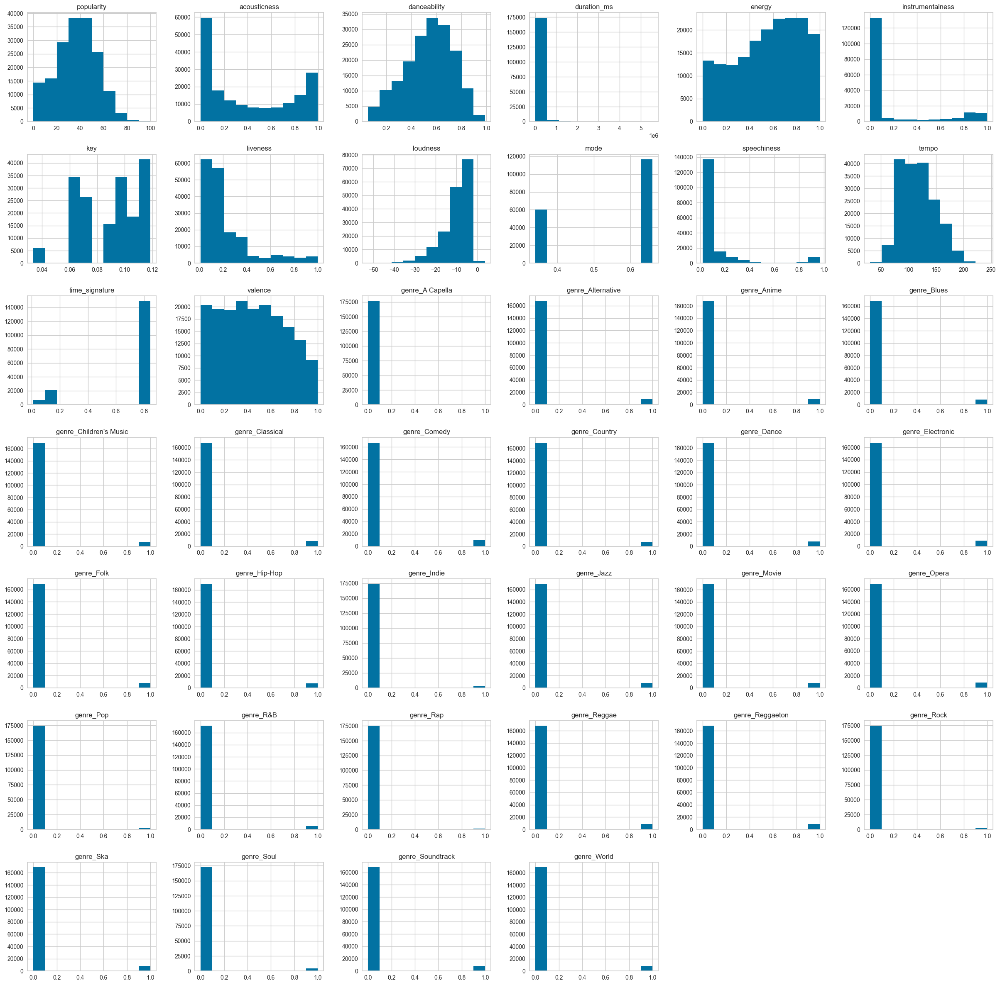

In [7]:
#5) Mirar histograma
df1.hist(figsize=(30, 30)), 

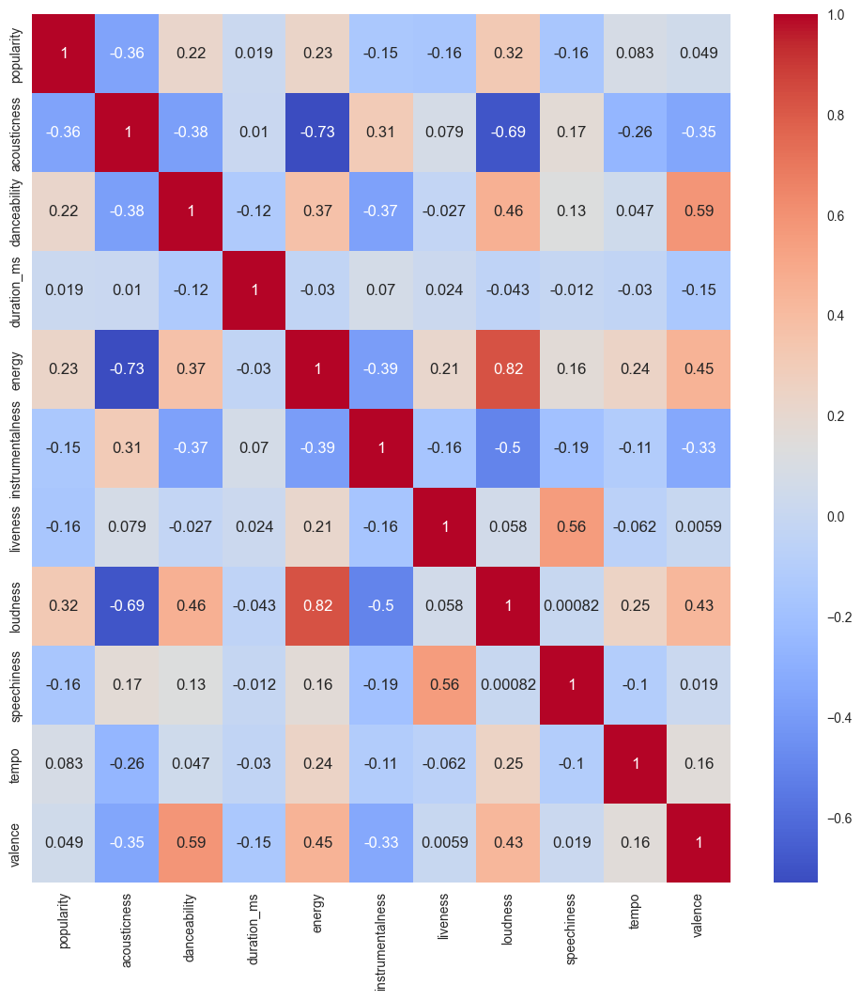

In [8]:
#6) Mirar correlació (pearson)
corr_matrix3 = df1[num_col].corr()
plt.figure(figsize=(12, 12))
ax = sns.heatmap(corr_matrix3, annot=True, cmap='coolwarm')
plt.show()

In [9]:
#7) Escalar columnes
scaler = StandardScaler()
data1_scal = scaler.fit_transform(df1)
#df1_scal = pd.DataFrame(data=scaler.fit_transform(data), columns=data.columns)

# D) Establir model

## 1) KMeans

Exception in thread Thread-5 (_readerthread):
Traceback (most recent call last):
  File "c:\Users\gaofu\anaconda3\Lib\threading.py", line 1038, in _bootstrap_inner
    self.run()
  File "c:\Users\gaofu\anaconda3\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "c:\Users\gaofu\anaconda3\Lib\threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "c:\Users\gaofu\anaconda3\Lib\subprocess.py", line 1597, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xa2 in position 116: invalid start byte


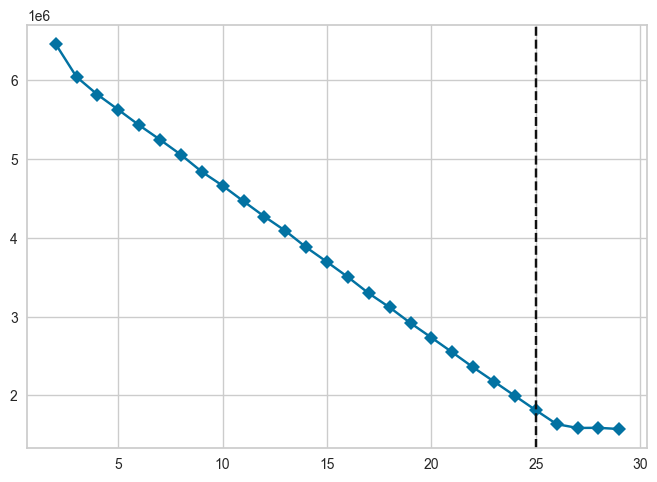

In [10]:
#DATASET3
#1) Calcular k millor
model = KMeans(n_init=10, random_state=0)
visualizer = KElbowVisualizer(model, k=(2,30), timings=False, metric='distortion') #default distance_metric: euclidean
visualizer.fit(data1_scal)       
#visualizer.show() #Quitar en py
#visualizer.show(outpath="kmeans.png") #Guardar gráfica
k = visualizer.elbow_value_ #millor k
#2) Entrenar i predir amb KMEANS
kmeans = KMeans(n_clusters=k, n_init=10, random_state=0)
#kmeans = MiniBatchKMeans(n_clusters=k, n_init=10, random_state=0)
kmeans1 = kmeans.fit_predict(data1_scal) #Mateix que: kmeans.labels__
#data_scal["cluster"] = pred

## 2) DBSCAN

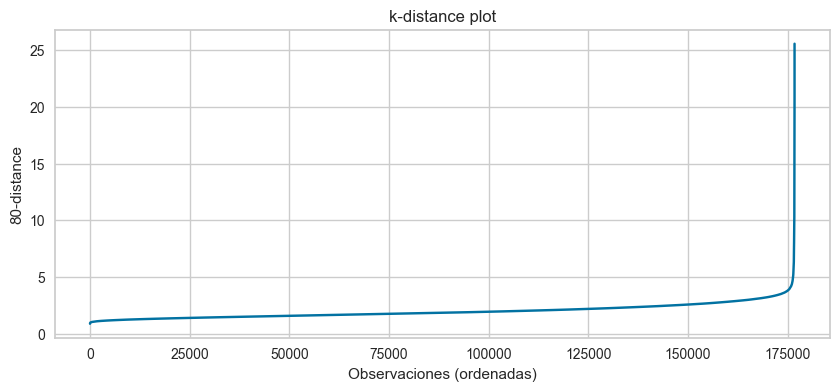

3.7877611351123175


In [11]:
#DATASET3
#1) Calcular eps
min_samples = 2 * data1_scal.shape[1]
nn = NearestNeighbors(n_neighbors=min_samples).fit(data1_scal) #default algorithm: auto; most appropiate, default metric: minkowski
dists, _ = nn.kneighbors(data1_scal)
kdist = np.sort(dists[:, -1])
plt.figure(figsize=(10,4))
plt.plot(kdist, label=f'{min_samples}-distance sorted')
plt.title('k-distance plot')
plt.xlabel('Observaciones (ordenadas)')
plt.ylabel(f'{min_samples}-distance')
plt.savefig("dbscan.png")
plt.show()
print(kdist[175000])

In [12]:
#2) Entrenar i predir amb DBSCAN
min_samples = 2 * data1_scal.shape[1]
dbscan = DBSCAN(eps=3.8, min_samples=min_samples, n_jobs=-1,) #default algorithm: auto of NearestNeighbours; most appropiate
dbscan1 = dbscan.fit_predict(data1_scal)
#print(calinski_harabasz_score(data1_scal, dbscan1), davies_bouldin_score(data1_scal, dbscan1))

## 3) HDBSCAN

In [13]:
#DATASET3
#1) Entrenar i predir amb HDBSCAN
min_samples = 2 * data1_scal.shape[1]
hdbscan = HDBSCAN(min_cluster_size=min_samples, min_samples=min_samples, n_jobs=-1, store_centers="centroid") #default metric: euclidean
hdbscan1 = hdbscan.fit_predict(data1_scal)

## 4) Gaussian Mixture

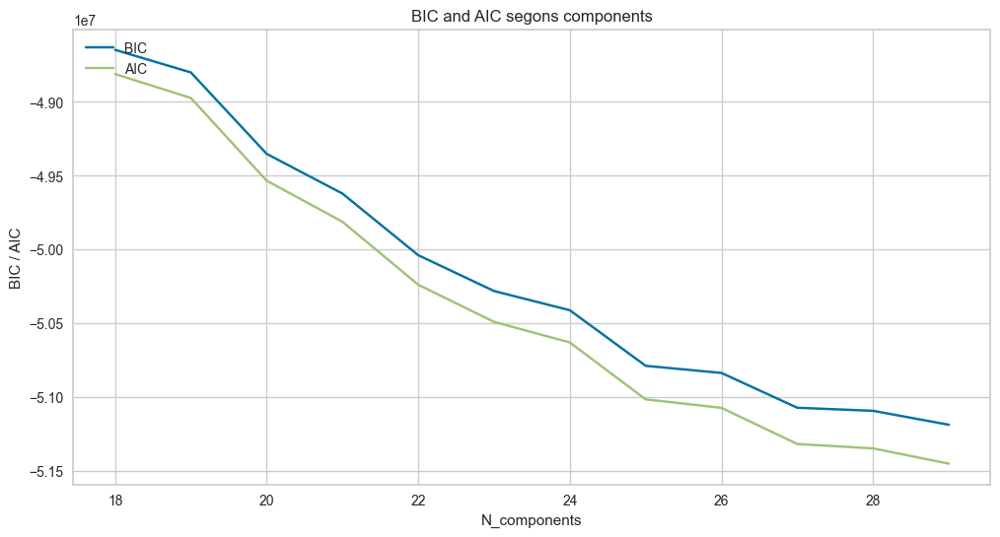

In [ ]:
#DATASET3
#1) Trobar n_components
n_components_range = range(18, 30)
bics = []
aics = []

for n in n_components_range:
    gmm = GaussianMixture(n_components=n, n_init=10, random_state=0)
    gmm.fit(data1_scal)
    bics.append(gmm.bic(data1_scal))
    aics.append(gmm.aic(data1_scal))

plt.figure(figsize=(12, 6))
plt.plot(n_components_range, bics, label='BIC')
plt.plot(n_components_range, aics, label='AIC')
plt.xlabel('N_components')
plt.ylabel('BIC / AIC')
plt.legend(loc=2)
plt.title('BIC and AIC segons components')
plt.savefig("gm.png")
plt.show()

In [14]:
#DATASET3
#2) Entrenar i predir amb GM
gm = GaussianMixture(n_components=25, n_init=10, random_state=0) #default covariance_type: full 
gm1 = gm.fit_predict(data1_scal)

# E) Evaluar models

In [15]:
#KMEANS
print(calinski_harabasz_score(data1_scal, kmeans1), davies_bouldin_score(data1_scal, kmeans1))

21365.010004585023 0.8837136513261957


In [16]:
#DBSCAN
print(calinski_harabasz_score(data1_scal, dbscan1), davies_bouldin_score(data1_scal, dbscan1))

22835.382580932754 1.0543129468970185


In [17]:
#HDBSCAN
print(calinski_harabasz_score(data1_scal, hdbscan1), davies_bouldin_score(data1_scal, hdbscan1))

23456.056832250746 0.8088244464236193


In [18]:
#GaussianMixture
print(calinski_harabasz_score(data1_scal, gm1), davies_bouldin_score(data1_scal, gm1))

21364.7696365001 0.8837005835017352


In [23]:
len(set(kmeans1)), len(set(dbscan1)), len(set(hdbscan1)), len(set(gm1))

(25, 27, 27, 25)

# F) Visualitzar clústers

In [110]:
# Crear sampled dataset per proves més ràpides
# Samplearem 15% de les dades per a proves
sample_size = int(len(df) * 0.15)
#sample_size = int(len(df) * 0.15 / len(set(hdbscan1)))

#df1_hdbscan1 = pd.DataFrame(data=data1_scal, columns=df1.columns)
#df1_hdbscan1["label"] = hdbscan1
#sample_indices = df1_hdbscan1.groupby("label").apply(lambda x: x.sample(sample_size, random_state=0) if len(x) >= sample_size else x, include_groups=False).droplevel("label").index
sample_indices = np.random.RandomState(42).choice(len(df), sample_size, replace=False)

df1_sample = data1_scal[sample_indices]
#pred= pred[sample_indices]
print("Mida orignal:", df.shape)
print("Mida 20%:", df1_sample.shape)

Mida orignal: (176767, 15)
Mida 20%: (26515, 40)


## 1) HDBSCAN

In [167]:
# 1. PCA Estàndard
pca_sample = PCA(n_components=2, random_state=42)
df1_sample_pca = pca_sample.fit_transform(df1_sample)

df1_sample_pca_2 = pd.DataFrame(data=df1_sample_pca, columns=['Component 1', 'Component 2'])
df1_sample_pca_2["kmeans"] = kmeans1[sample_indices]
df1_sample_pca_2["dbscan"] = dbscan1[sample_indices]
df1_sample_pca_2["hdbscan"] = hdbscan1[sample_indices]

# 2. KernelPCA RBF
kpca_sample = KernelPCA(n_components=2, kernel='rbf', random_state=42, n_jobs=-1)
df1_sample_kpca = kpca_sample.fit_transform(df1_sample)

df1_sample_kpca_2 = pd.DataFrame(data=df1_sample_kpca, columns=['Component 1', 'Component 2'])
df1_sample_kpca_2["kmeans"] = kmeans1[sample_indices]
df1_sample_kpca_2["dbscan"] = dbscan1[sample_indices]
df1_sample_kpca_2["hdbscan"] = hdbscan1[sample_indices]

# 3. TruncatedSVD
tsvd_sample = TruncatedSVD(n_components=2, random_state=42)
df1_sample_tsvd = tsvd_sample.fit_transform(df1_sample)

df1_sample_tsvd_2 = pd.DataFrame(data=df1_sample_tsvd, columns=['Component 1', 'Component 2'])
df1_sample_tsvd_2["kmeans"] = kmeans1[sample_indices]
df1_sample_tsvd_2["dbscan"] = dbscan1[sample_indices]
df1_sample_tsvd_2["hdbscan"] = hdbscan1[sample_indices]

# 4. TSNE
tsne = TSNE(n_components=2, perplexity=50, learning_rate='auto', random_state=42)
df1_sample_tsne = tsne.fit_transform(df1_sample)
df1_sample_tsne_2 = pd.DataFrame(data=df1_sample_tsne, columns=['Component 1', 'Component 2'])
df1_sample_tsne_2["kmeans"] = kmeans1[sample_indices]
df1_sample_tsne_2["dbscan"] = dbscan1[sample_indices]
df1_sample_tsne_2["hdbscan"] = hdbscan1[sample_indices]

In [170]:
pca_sample.explained_variance_ratio_.cumsum(), tsvd_sample.explained_variance_ratio_.cumsum(), tsne.kl_divergence_

(array([0.11197349, 0.18041047]),
 array([0.11197348, 0.18040966]),
 1.21981942653656)

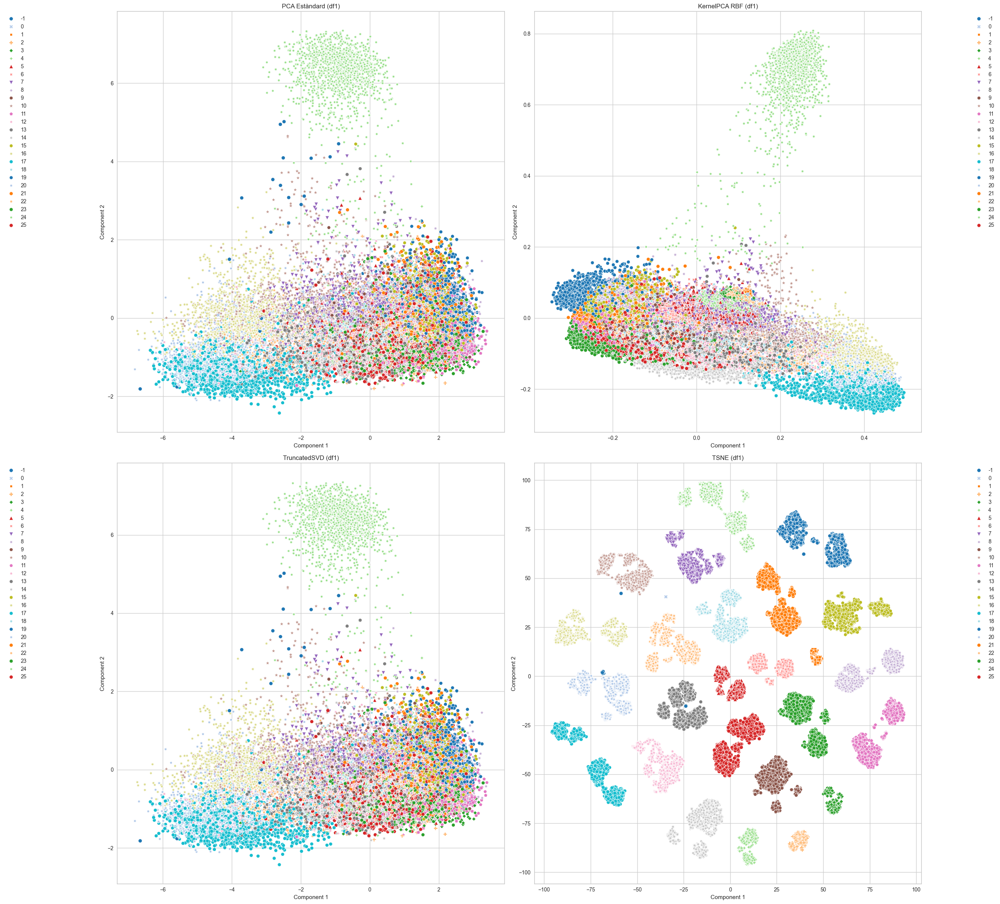

In [168]:
#HDBSCAN
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
df1_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_pca_2, x='Component 1', y='Component 2', hue='hdbscan', style='hdbscan',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df1)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
df1_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_kpca_2, x='Component 1', y='Component 2', hue='hdbscan',  style='hdbscan',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df1)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
df1_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_tsvd_2, x='Component 1', y='Component 2', hue='hdbscan',  style='hdbscan',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df1)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
df1_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_tsne_2, x='Component 1', y='Component 2', hue='hdbscan', style='hdbscan',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df1)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

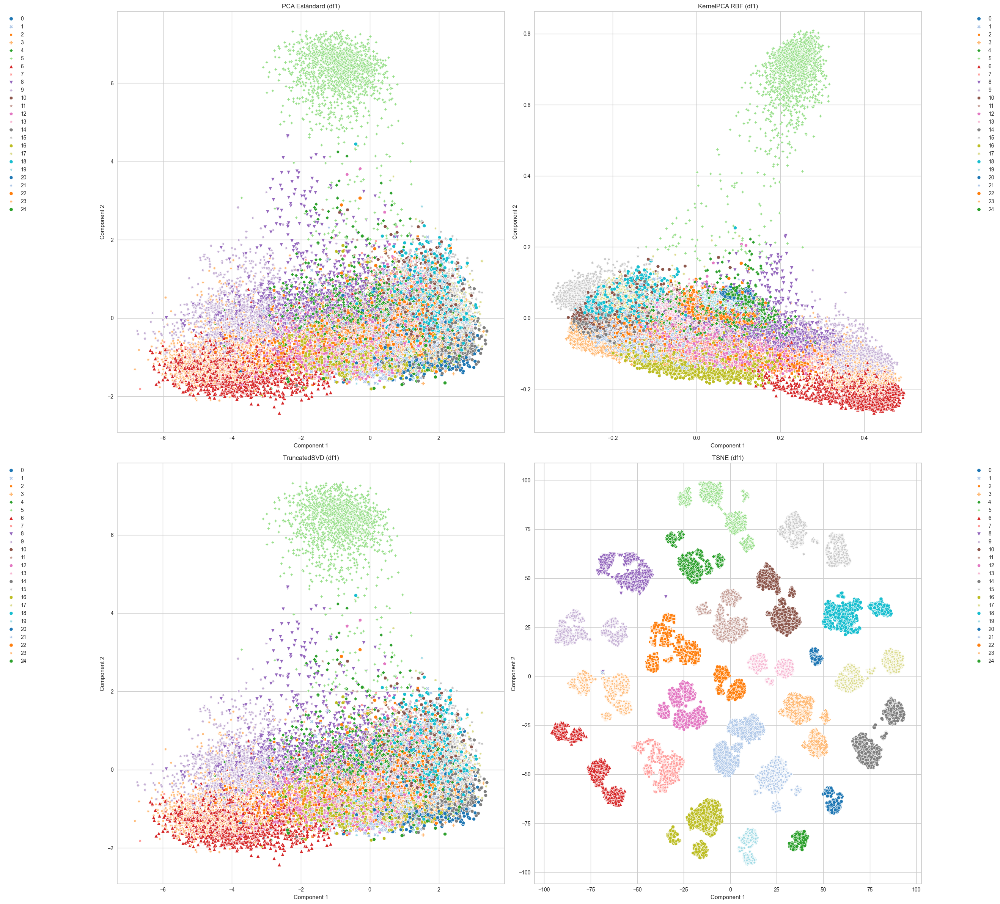

In [ ]:
#KMEANS
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
df1_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_pca_2, x='Component 1', y='Component 2', hue='kmeans', style='kmeans',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df1)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
df1_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_kpca_2, x='Component 1', y='Component 2', hue='kmeans',  style='kmeans',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df1)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
df1_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_tsvd_2, x='Component 1', y='Component 2', hue='kmeans',  style='kmeans',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df1)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
df1_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_tsne_2, x='Component 1', y='Component 2', hue='kmeans', style='kmeans',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df1)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

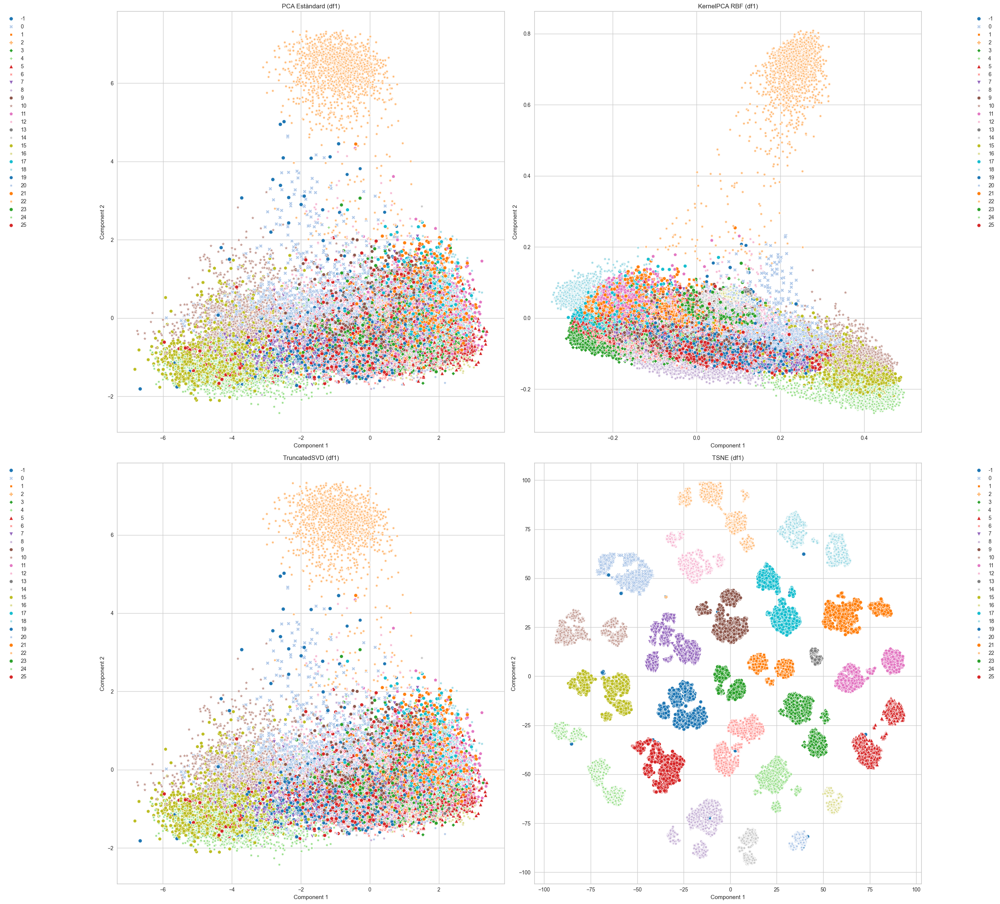

In [171]:
#DBSCAN
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
df1_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_pca_2, x='Component 1', y='Component 2', hue='dbscan', style='dbscan',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df1)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
df1_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_kpca_2, x='Component 1', y='Component 2', hue='dbscan',  style='dbscan',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df1)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
df1_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_tsvd_2, x='Component 1', y='Component 2', hue='dbscan',  style='dbscan',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df1)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
df1_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_tsne_2, x='Component 1', y='Component 2', hue='dbscan', style='dbscan',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df1)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

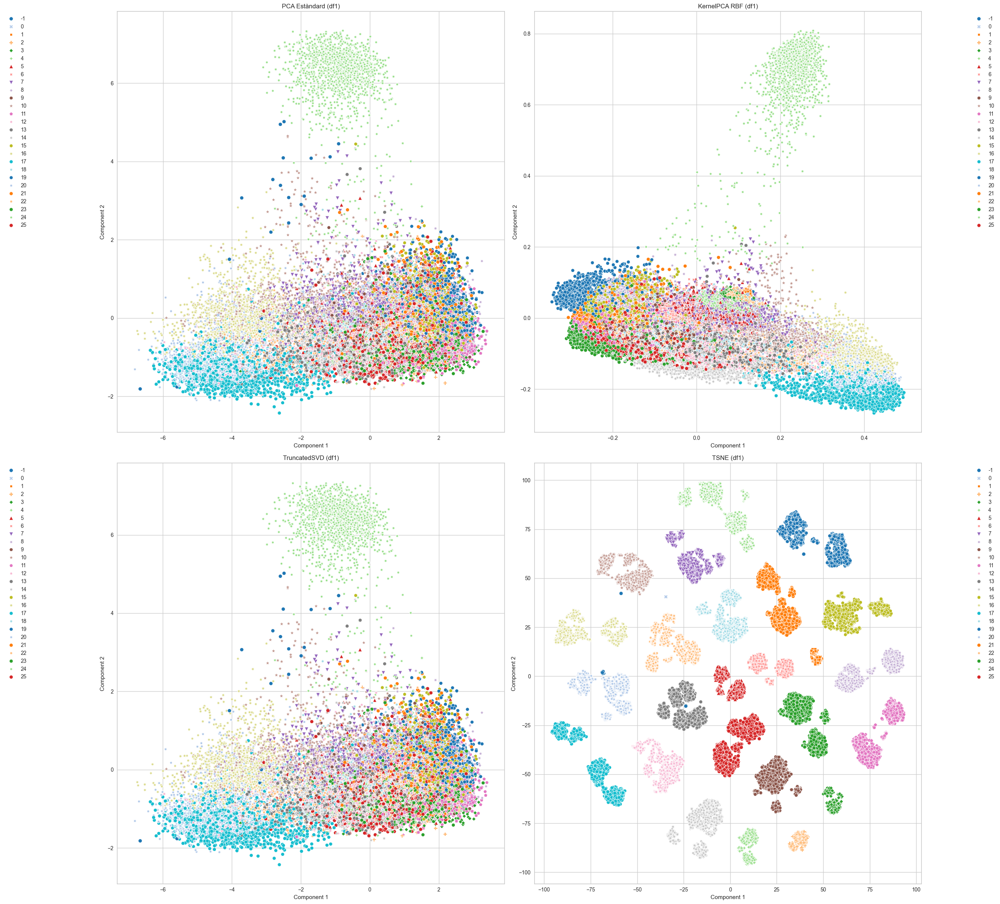

In [ ]:
#BASE
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
pca_sample = PCA(n_components=2, random_state=42)
df1_sample_pca = pca_sample.fit_transform(df1_sample)

df1_sample_pca_2 = pd.DataFrame(data=df1_sample_pca, columns=['Component 1', 'Component 2'])
df1_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_pca_2, x='Component 1', y='Component 2', hue='Cluster', style='Cluster',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df1)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
kpca_sample = KernelPCA(n_components=2, kernel='rbf', random_state=42, n_jobs=-1)
df1_sample_kpca = kpca_sample.fit_transform(df1_sample)

df1_sample_kpca_2 = pd.DataFrame(data=df1_sample_kpca, columns=['Component 1', 'Component 2'])
df1_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_kpca_2, x='Component 1', y='Component 2', hue='Cluster',  style='Cluster',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df1)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
tsvd_sample = TruncatedSVD(n_components=2, random_state=42)
df1_sample_tsvd = tsvd_sample.fit_transform(df1_sample)

df1_sample_tsvd_2 = pd.DataFrame(data=df1_sample_tsvd, columns=['Component 1', 'Component 2'])
df1_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df1_sample_tsvd_2, x='Component 1', y='Component 2', hue='Cluster',  style='Cluster',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df1)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
tsne = TSNE(n_components=2, perplexity=50, learning_rate='auto', random_state=42)
df1_sample_tsne = tsne.fit_transform(df1_sample)
df1_sample_tsne_2 = pd.DataFrame(data=df1_sample_tsne, columns=['Component 1', 'Component 2'])
df1_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]

sns.scatterplot(data=df1_sample_tsne_2, x='Component 1', y='Component 2', hue='Cluster', style='Cluster',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df1)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

# H) Anàlisi

<Axes: ylabel='label'>

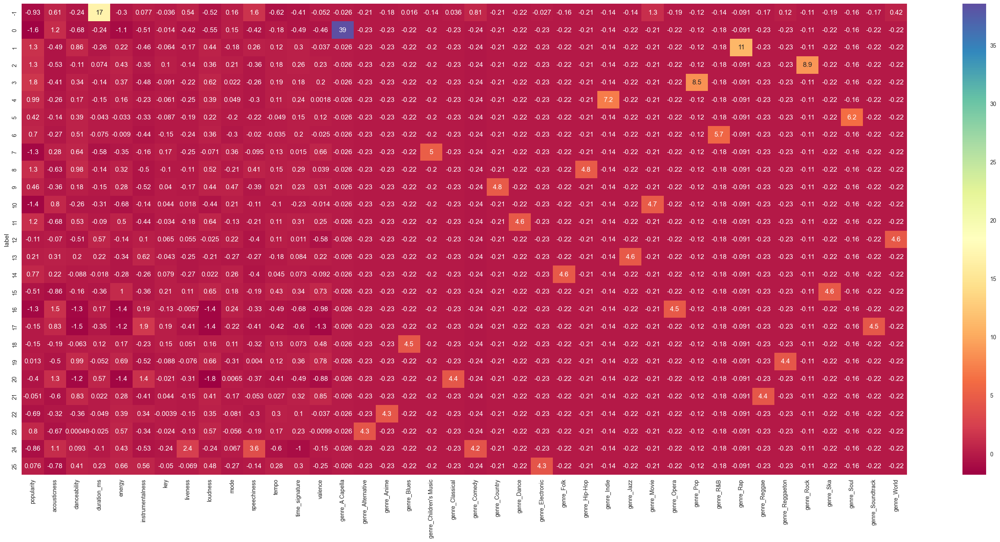

In [111]:
df1_hdbscan1 = pd.DataFrame(data=data1_scal, columns=df1.columns)
df1_hdbscan1["label"] = hdbscan1

tmp = df1_hdbscan1.groupby(by=["label"]).mean()

plt.figure(figsize=(35, 15))
sns.heatmap(tmp, cmap="Spectral", annot=True)

C:\Users\gaofu\AppData\Local\Temp\ipykernel_20524\2497062022.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df1_hdbscan1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_20524\2497062022.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df1_hdbscan1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_20524\2497062022.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df1_hdbscan1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_20524\2497062022.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df1_hdbscan1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ip

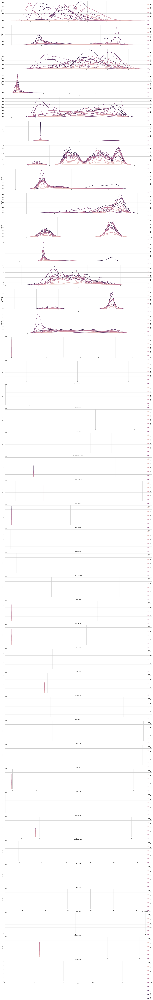

In [117]:
fig, axes = plt.subplots(len(df1_hdbscan1.columns), figsize=(30, 200))

for i, c in enumerate(df1_hdbscan1.columns): 
    sns.kdeplot(df1_hdbscan1, x=c, hue="label", ax=axes[i])

plt.show()

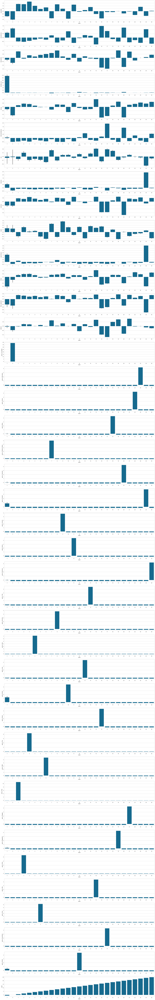

In [119]:
fig, axes = plt.subplots(len(df1_hdbscan1.columns), figsize=(30, 200))

for i, c in enumerate(df1_hdbscan1.columns): 
    sns.barplot(df1_hdbscan1, y=c, x="label", ax=axes[i])

plt.show()

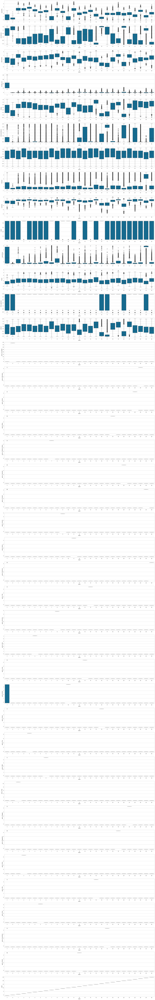

In [141]:
fig, axes = plt.subplots(len(df1_hdbscan1.columns), figsize=(30, 200))

for i, c in enumerate(df1_hdbscan1.columns): 
    sns.boxplot(df1_hdbscan1, x="label", y=c, ax=axes[i])

plt.show()

# Random songs

In [138]:
cluster_labels = sorted([label for label in set(hdbscan1) if label != -1]) #totes les labels del model
sizes = {label: int((hdbscan1 == label).sum()) for label in cluster_labels} #quanitat de cancos en cada label

random_index = np.random.RandomState(42).randint(len(data1_scal)) #index de canço random
random_label = hdbscan1[random_index] #label de canço random

cluster_index = np.where(hdbscan1 == random_label)[0] #index de cancons amb label de canço random 

recomancio = 2
random_recomancio_index = np.random.RandomState(42).choice(cluster_index, size=recomancio, replace=False) #index de 

#print("Nom canço:", canciones.loc[:, "track_name"][random_index].values)
#print("Nom artista:", canciones.loc[:, "artist_name"][random_index].values)
print("Nom canço:", canciones["track_name"][random_index])
print("Nom artista:", canciones["artist_name"][random_index])
print("Label:", hdbscan1[random_index])
print("Cançons disponibles:", sizes[random_label])

for i in range(recomancio): 
    print("RECOMANCIO", i)
    print("Nom canço:", canciones["track_name"][random_recomancio_index[i]])
    print("Nom artista:", canciones["artist_name"][random_recomancio_index[i]])
    print("Label:", hdbscan1[random_recomancio_index[i]])

Nom canço: Donde Esta Mi Gata
Nom artista: Yandel
Label: 19
Cançons disponibles: 8536
RECOMANCIO 0
Nom canço: Mi Amor
Nom artista: Grupo Treo
Label: 19
RECOMANCIO 1
Nom canço: Suave Y Lento
Nom artista: Jowell & Randy
Label: 19
